In [1]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import imageio
import os
from IPython.display import display, Image

# Define file path
file_path = "/Users/markbogorad/Desktop/NYU_MFE/Semester_2/1.2_Trading_Energy_Derivatives_MATH_GA_2800/Oil_Project/Systematic_Energy_Trading/Data/NGLs.xlsx"

# Load the Excel file once
xls = pd.ExcelFile(file_path)

# Print available sheet names for reference
print("Available Sheets:", xls.sheet_names)



Available Sheets: ['NG', 'CAP', 'BAP', 'DAE', 'IBD', 'MMB', 'PCW', 'PGP']


In [2]:
def load_futures_data(sheet_name):
    """
    Loads and cleans futures price data from a specific sheet.

    Parameters:
    - sheet_name: The name of the sheet to load.

    Returns:
    - Cleaned DataFrame with formatted date column.
    """
    # Load sheet with correct header row
    df = pd.read_excel(xls, sheet_name=sheet_name, header=4, na_values=['#N/A', 'N/A'])
    
    # Rename columns for consistency
    df.rename(columns={"Dates": "date"}, inplace=True)
    df["date"] = pd.to_datetime(df["date"], errors="coerce")

    # Drop rows with all NaNs (especially for futures columns)
    df.dropna(subset=df.columns[1:], how="all", inplace=True)
    df.reset_index(drop=True, inplace=True)

    print(f"✅ Loaded and cleaned {sheet_name} data:")
    display(df.head())

    return df


✅ Loaded and cleaned NG data:


,date,NG1 Comdty,NG2 Comdty,NG3 Comdty,NG4 Comdty,NG5 Comdty,NG6 Comdty,NG7 Comdty,NG8 Comdty,NG9 Comdty,...,NG15 Comdty,NG16 Comdty,NG17 Comdty,NG18 Comdty,NG19 Comdty,NG20 Comdty,NG21 Comdty,NG22 Comdty,NG23 Comdty,NG24 Comdty
0,2011-07-07,4.133,4.138,4.168,4.324,4.535,4.642,4.644,4.608,4.525,...,4.706,4.856,5.088,5.202,5.171,5.096,4.881,4.893,4.927,4.966
1,2011-07-08,4.205,4.204,4.231,4.385,4.600,4.709,4.710,4.673,4.586,...,4.769,4.921,5.152,5.267,5.235,5.160,4.940,4.952,4.986,5.025
2,2011-07-11,4.288,4.277,4.302,4.447,4.656,4.764,4.765,4.728,4.642,...,4.824,4.976,5.203,5.318,5.286,5.211,4.993,5.005,5.039,5.078
3,2011-07-12,4.333,4.312,4.335,4.473,4.675,4.783,4.782,4.741,4.654,...,4.834,4.983,5.210,5.324,5.292,5.217,4.999,5.011,5.045,5.084
4,2011-07-13,4.403,4.387,4.411,4.540,4.737,4.845,4.843,4.796,4.706,...,4.882,5.027,5.249,5.362,5.330,5.254,5.034,5.046,5.080,5.119


/var/folders/r6/6h8mtjj914j_0j9_yn_4cm1m0000gn/T/ipykernel_72373/1367239823.py:58: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(frame)


✅ GIF saved at: ng_futures_rolling.gif (Frames: 324, Step: 11)


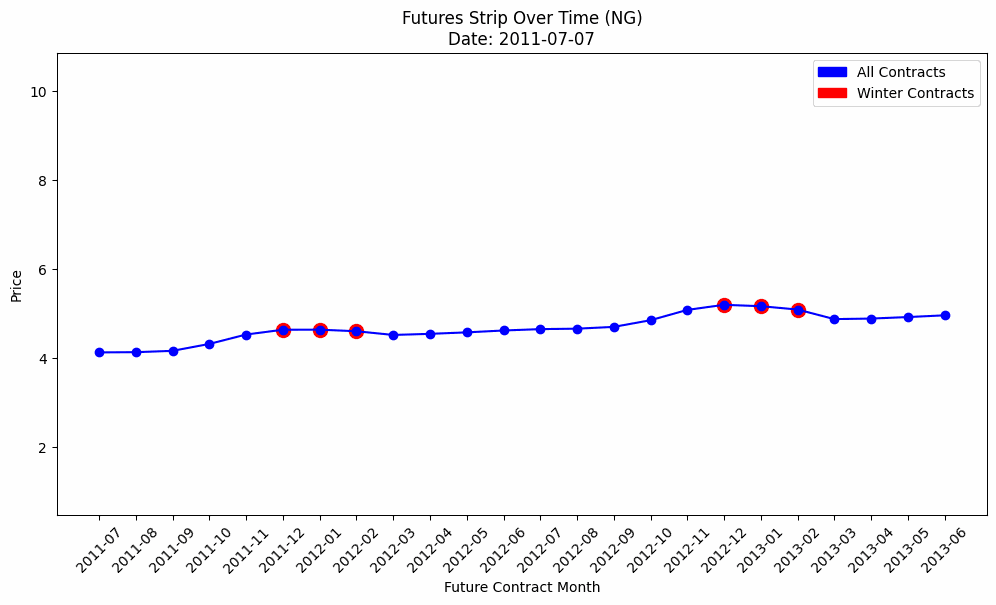

In [3]:
# Load NG data
df_ng = load_futures_data(sheet_name="NG")

def generate_futures_gif(df, sheet_name="NG", save_path="ng_futures_rolling.gif", duration=1000, max_frames=300):
    import matplotlib.patches as mpatches
    
    image_folder = "gif_frames"
    os.makedirs(image_folder, exist_ok=True)

    frames = []
    num_contracts = df.shape[1] - 1  # Exclude 'date' column
    total_rows = len(df)

    # Dynamically adjust step to limit frames
    step = max(1, total_rows // max_frames)

    # Select rows to plot (spaced evenly)
    selected_rows = df.iloc[::step].reset_index(drop=True)

    # Predefine legend handles for consistency
    all_contracts_patch = mpatches.Patch(color='blue', label='All Contracts')
    winter_patch = mpatches.Patch(color='red', label='Winter Contracts')

    for i, row in selected_rows.iterrows():
        # Generate dynamic contract months starting from the current date
        start_month = row["date"]
        contract_months = [start_month + pd.DateOffset(months=j) for j in range(num_contracts)]
        contract_labels = [month.strftime("%Y-%m") for month in contract_months]
        prices = row[1:].values

        plt.figure(figsize=(12, 6))

        # Plot all prices
        plt.plot(contract_labels, prices, marker='o', linestyle='-', color='blue')

        # Highlight winter months (Dec-Feb)
        for idx, month in enumerate(contract_months):
            if month.month in [12, 1, 2]:
                plt.scatter(contract_labels[idx], prices[idx], color='red', s=100)

        plt.xlabel("Future Contract Month")
        plt.ylabel("Price")
        plt.title(f"Futures Strip Over Time ({sheet_name})\nDate: {row['date'].strftime('%Y-%m-%d')}")
        plt.xticks(rotation=45)
        plt.ylim(df.iloc[:, 1:].min().min() - 1, df.iloc[:, 1:].max().max() + 1)  # Fixed scale for consistency

        # Static legend added once
        plt.legend(handles=[all_contracts_patch, winter_patch])

        frame_path = os.path.join(image_folder, f"frame_{i:03d}.png")
        plt.savefig(frame_path, bbox_inches="tight")
        plt.close()
        frames.append(frame_path)

    # Create GIF
    with imageio.get_writer(save_path, mode='I', duration=duration / 1000) as writer:
        for frame in frames:
            image = imageio.imread(frame)
            writer.append_data(image)

    print(f"✅ GIF saved at: {save_path} (Frames: {len(frames)}, Step: {step})")
    display(Image(filename=save_path))  # Display the GIF in Jupyter

# Run GIF generation for NG with rolling months and winter highlights
generate_futures_gif(df_ng, sheet_name="NG", save_path="ng_futures_rolling.gif", duration=1000, max_frames=300)



✅ Loaded and cleaned CAP data:


,date,CAP1 Comdty,CAP2 Comdty,CAP3 Comdty,CAP4 Comdty,CAP5 Comdty,CAP6 Comdty,CAP7 Comdty,CAP8 Comdty,CAP9 Comdty,...,CAP15 Comdty,CAP16 Comdty,CAP17 Comdty,CAP18 Comdty,CAP19 Comdty,CAP20 Comdty,CAP21 Comdty,CAP22 Comdty,CAP23 Comdty,CAP24 Comdty
0,2011-07-07,0.81141,0.80391,0.78141,0.75891,0.73672,0.71328,0.69813,0.68000,0.66188,...,0.57625,0.56875,0.56125,0.55375,0.5618,0.5618,0.56180,0.56180,0.56180,0.56180
1,2011-07-08,0.80528,0.79750,0.77844,0.75750,0.73563,0.71250,0.69875,0.68063,0.66250,...,0.57250,0.56500,0.55750,0.55000,0.5623,0.5623,0.56230,0.56230,0.56230,0.56230
2,2011-07-11,0.80514,0.79781,0.77906,0.75750,0.73531,0.71219,0.69750,0.67938,0.66125,...,0.56875,0.56125,0.55375,0.54625,0.5592,0.5592,0.55920,0.55920,0.55920,0.55920
3,2011-07-12,0.80509,0.79906,0.77969,0.75875,0.73625,0.71281,0.69813,0.68188,0.66313,...,0.56875,0.56125,0.55375,0.54625,0.5322,0.5322,0.53220,0.53220,0.53220,0.53220
4,2011-07-13,0.80294,0.79656,0.77719,0.75594,0.73438,0.71125,0.69688,0.68063,0.66188,...,0.56500,0.55750,0.55000,0.54250,0.5400,0.5375,0.52844,0.52844,0.52844,0.52844


/var/folders/r6/6h8mtjj914j_0j9_yn_4cm1m0000gn/T/ipykernel_72373/780182547.py:64: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(frame)


✅ GIF saved at: cap_futures.gif (Frames: 324, Step: 11)


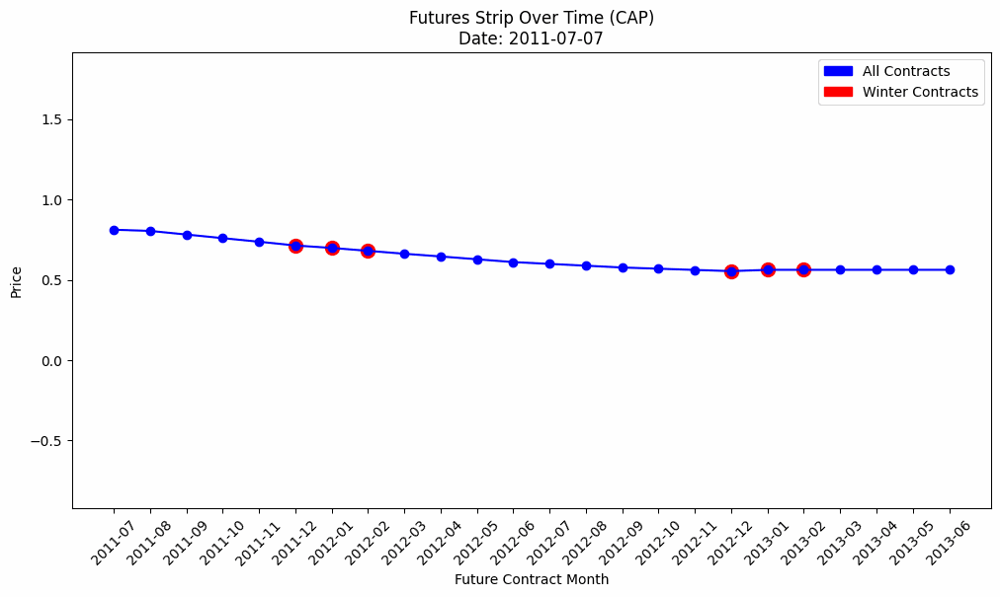

In [4]:
df_ng = load_futures_data(sheet_name="CAP")

import os
import numpy as np
import imageio
import matplotlib.pyplot as plt
from IPython.display import Image, display

def generate_futures_gif(df, sheet_name="CAP", save_path="cap_futures_full.gif", duration=1000, max_frames=300):

    import matplotlib.patches as mpatches
    
    image_folder = "gif_frames"
    os.makedirs(image_folder, exist_ok=True)

    frames = []
    num_contracts = df.shape[1] - 1  # Exclude 'date' column
    total_rows = len(df)

    # Dynamically adjust step to limit frames
    step = max(1, total_rows // max_frames)

    # Select rows to plot (spaced evenly)
    selected_rows = df.iloc[::step].reset_index(drop=True)

    # Predefine legend handles for consistency
    all_contracts_patch = mpatches.Patch(color='blue', label='All Contracts')
    winter_patch = mpatches.Patch(color='red', label='Winter Contracts')

    for i, row in selected_rows.iterrows():
        # Generate dynamic contract months starting from the current date
        start_month = row["date"]
        contract_months = [start_month + pd.DateOffset(months=j) for j in range(num_contracts)]
        contract_labels = [month.strftime("%Y-%m") for month in contract_months]
        prices = row[1:].values

        plt.figure(figsize=(12, 6))

        # Plot all prices
        plt.plot(contract_labels, prices, marker='o', linestyle='-', color='blue')

        # Highlight winter months (Dec-Feb)
        for idx, month in enumerate(contract_months):
            if month.month in [12, 1, 2]:
                plt.scatter(contract_labels[idx], prices[idx], color='red', s=100)

        plt.xlabel("Future Contract Month")
        plt.ylabel("Price")
        plt.title(f"Futures Strip Over Time ({sheet_name})\nDate: {row['date'].strftime('%Y-%m-%d')}")
        plt.xticks(rotation=45)
        plt.ylim(df.iloc[:, 1:].min().min() - 1, df.iloc[:, 1:].max().max() + 1)  # Fixed scale for consistency

        # Static legend added once
        plt.legend(handles=[all_contracts_patch, winter_patch])

        frame_path = os.path.join(image_folder, f"frame_{i:03d}.png")
        plt.savefig(frame_path, bbox_inches="tight")
        plt.close()
        frames.append(frame_path)

    # Create GIF
    with imageio.get_writer(save_path, mode='I', duration=duration / 1000) as writer:
        for frame in frames:
            image = imageio.imread(frame)
            writer.append_data(image)

    print(f"✅ GIF saved at: {save_path} (Frames: {len(frames)}, Step: {step})")
    display(Image(filename=save_path))  # Display the GIF in Jupyter

# Run full-sample GIF generation
generate_futures_gif(df_ng, sheet_name="CAP", save_path="cap_futures.gif", duration=1000, max_frames=300)

✅ Loaded and cleaned BAP data:


,date,BAP1 Comdty,BAP2 Comdty,BAP3 Comdty,BAP4 Comdty,BAP5 Comdty,BAP6 Comdty,BAP7 Comdty,BAP8 Comdty,BAP9 Comdty,...,BAP15 Comdty,BAP16 Comdty,BAP17 Comdty,BAP18 Comdty,BAP19 Comdty,BAP20 Comdty,BAP21 Comdty,BAP22 Comdty,BAP23 Comdty,BAP24 Comdty
0,2011-07-11,1.51947,1.52708,1.53375,1.54000,1.54667,1.55417,1.56167,1.53292,1.44125,...,1.37750,1.38375,1.39000,1.39625,1.31927,1.31927,1.31927,1.31927,1.31927,1.31927
1,2011-07-12,1.53045,1.54417,1.55208,1.55958,1.56708,1.57458,1.57875,1.55042,1.45875,...,1.40000,1.40750,1.41500,1.42250,1.32688,1.32688,1.32688,1.32688,1.32688,1.32688
2,2011-07-13,1.52457,1.53583,1.54375,1.55125,1.55875,1.56667,1.57625,1.55000,1.45708,...,1.39875,1.40625,1.41375,1.42125,1.42875,1.40625,1.32563,1.32563,1.32563,1.32563
3,2011-07-14,1.51784,1.52458,1.53292,1.54042,1.54792,1.55583,1.56458,1.53792,1.44500,...,1.38500,1.39250,1.40000,1.40750,1.41500,1.39250,1.31188,1.31188,1.31188,1.31188
4,2011-07-15,1.52659,1.53917,1.54708,1.55458,1.56208,1.57000,1.57792,1.55042,1.45042,...,1.39125,1.39875,1.40625,1.41375,1.42125,1.39875,1.31813,1.31813,1.31813,1.31813


/var/folders/r6/6h8mtjj914j_0j9_yn_4cm1m0000gn/T/ipykernel_72373/2072828162.py:64: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(frame)


✅ GIF saved at: bap_futures.gif (Frames: 324, Step: 11)


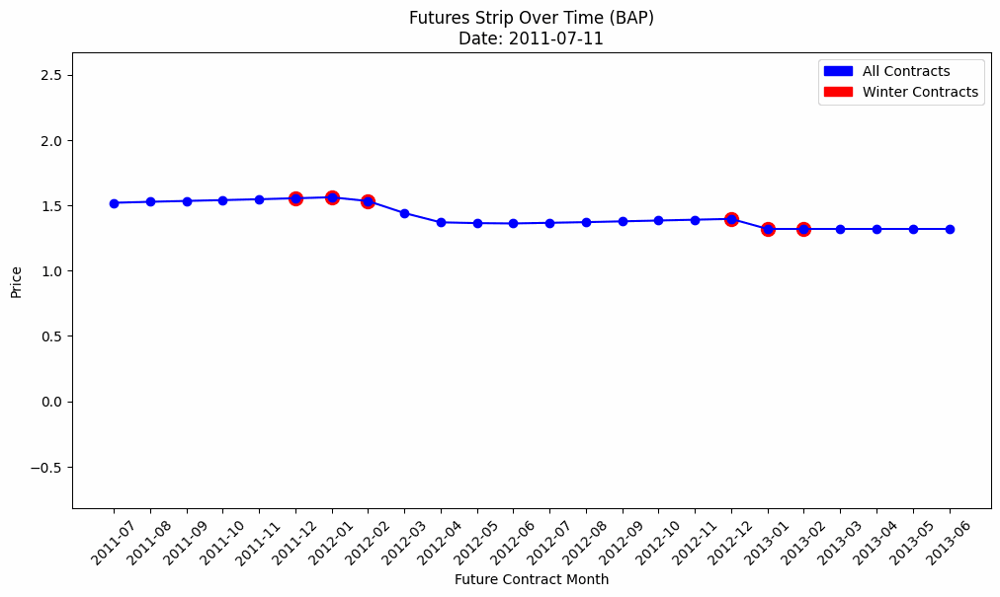

In [5]:
df_ng = load_futures_data(sheet_name="BAP")

import os
import numpy as np
import imageio
import matplotlib.pyplot as plt
from IPython.display import Image, display

def generate_futures_gif(df, sheet_name="BAP", save_path="bap_futures_full.gif", duration=1000, max_frames=300):
    
    import matplotlib.patches as mpatches
    
    image_folder = "gif_frames"
    os.makedirs(image_folder, exist_ok=True)

    frames = []
    num_contracts = df.shape[1] - 1  # Exclude 'date' column
    total_rows = len(df)

    # Dynamically adjust step to limit frames
    step = max(1, total_rows // max_frames)

    # Select rows to plot (spaced evenly)
    selected_rows = df.iloc[::step].reset_index(drop=True)

    # Predefine legend handles for consistency
    all_contracts_patch = mpatches.Patch(color='blue', label='All Contracts')
    winter_patch = mpatches.Patch(color='red', label='Winter Contracts')

    for i, row in selected_rows.iterrows():
        # Generate dynamic contract months starting from the current date
        start_month = row["date"]
        contract_months = [start_month + pd.DateOffset(months=j) for j in range(num_contracts)]
        contract_labels = [month.strftime("%Y-%m") for month in contract_months]
        prices = row[1:].values

        plt.figure(figsize=(12, 6))

        # Plot all prices
        plt.plot(contract_labels, prices, marker='o', linestyle='-', color='blue')

        # Highlight winter months (Dec-Feb)
        for idx, month in enumerate(contract_months):
            if month.month in [12, 1, 2]:
                plt.scatter(contract_labels[idx], prices[idx], color='red', s=100)

        plt.xlabel("Future Contract Month")
        plt.ylabel("Price")
        plt.title(f"Futures Strip Over Time ({sheet_name})\nDate: {row['date'].strftime('%Y-%m-%d')}")
        plt.xticks(rotation=45)
        plt.ylim(df.iloc[:, 1:].min().min() - 1, df.iloc[:, 1:].max().max() + 1)  # Fixed scale for consistency

        # Static legend added once
        plt.legend(handles=[all_contracts_patch, winter_patch])

        frame_path = os.path.join(image_folder, f"frame_{i:03d}.png")
        plt.savefig(frame_path, bbox_inches="tight")
        plt.close()
        frames.append(frame_path)

    # Create GIF
    with imageio.get_writer(save_path, mode='I', duration=duration / 1000) as writer:
        for frame in frames:
            image = imageio.imread(frame)
            writer.append_data(image)

    print(f"✅ GIF saved at: {save_path} (Frames: {len(frames)}, Step: {step})")
    display(Image(filename=save_path))  # Display the GIF in Jupyter

# Run full-sample GIF generation
generate_futures_gif(df_ng, sheet_name="BAP", save_path="bap_futures.gif", duration=1000, max_frames=300)

✅ Loaded and cleaned DAE data:


,date,DAE1 Comdty,DAE2 Comdty,DAE3 Comdty,DAE4 Comdty,DAE5 Comdty,DAE6 Comdty,DAE7 Comdty,DAE8 Comdty,DAE9 Comdty,...,DAE15 Comdty,DAE16 Comdty,DAE17 Comdty,DAE18 Comdty,DAE19 Comdty,DAE20 Comdty,DAE21 Comdty,DAE22 Comdty,DAE23 Comdty,DAE24 Comdty
0,2011-07-07,1.86025,1.87656,1.88406,1.89250,1.90094,1.90938,1.92375,1.90375,1.85375,...,1.78625,1.79125,1.79625,1.80125,1.73498,1.73498,1.73498,1.73498,1.73498,1.73498
1,2011-07-08,1.86875,1.88875,1.89656,1.90500,1.91375,1.92250,1.93125,1.91125,1.86125,...,1.79375,1.79875,1.80375,1.80875,1.74576,1.74576,1.74576,1.74576,1.74576,1.74576
2,2011-07-11,1.85609,1.87750,1.88500,1.89313,1.90125,1.90938,1.91875,1.89875,1.84875,...,1.78125,1.78625,1.79125,1.79625,1.73326,1.73326,1.73326,1.73326,1.73326,1.73326
3,2011-07-12,1.85953,1.88750,1.89594,1.90406,1.91188,1.92032,1.93125,1.91125,1.86125,...,1.79375,1.79875,1.80375,1.80875,1.72583,1.72583,1.72583,1.72583,1.72583,1.72583
4,2011-07-13,1.86663,1.88563,1.89406,1.90219,1.91031,1.91844,1.92750,1.90750,1.85500,...,1.78750,1.79250,1.79750,1.80250,1.81000,1.79500,1.71958,1.71958,1.71958,1.71958


/var/folders/r6/6h8mtjj914j_0j9_yn_4cm1m0000gn/T/ipykernel_72373/1893675634.py:64: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(frame)


✅ GIF saved at: dae_futures.gif (Frames: 324, Step: 11)


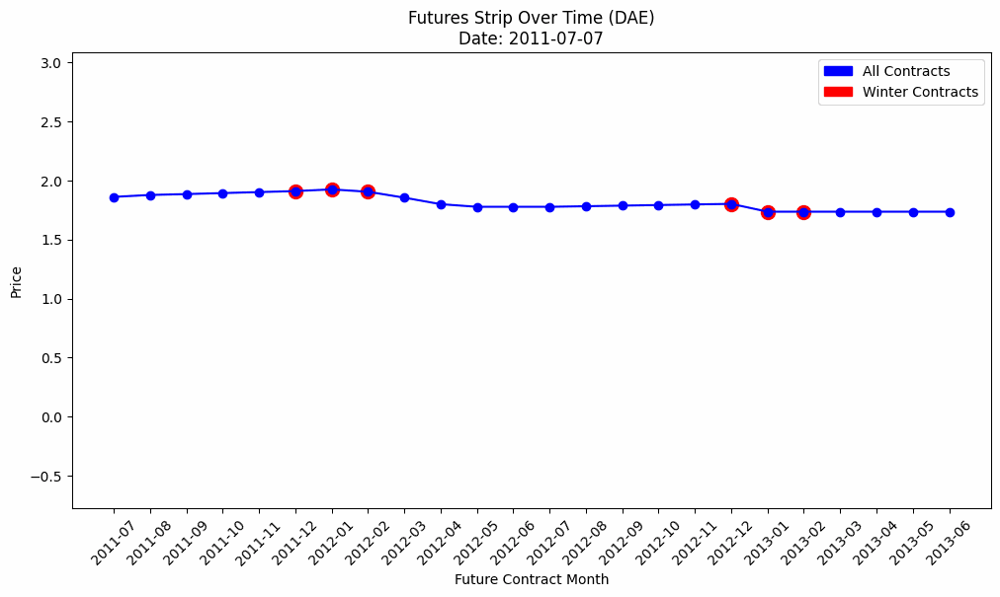

In [6]:
df_ng = load_futures_data(sheet_name="DAE")

import os
import numpy as np
import imageio
import matplotlib.pyplot as plt
from IPython.display import Image, display

def generate_futures_gif(df, sheet_name="DAE", save_path="DAE_futures_full.gif", duration=1000, max_frames=300):

    import matplotlib.patches as mpatches
    
    image_folder = "gif_frames"
    os.makedirs(image_folder, exist_ok=True)

    frames = []
    num_contracts = df.shape[1] - 1  # Exclude 'date' column
    total_rows = len(df)

    # Dynamically adjust step to limit frames
    step = max(1, total_rows // max_frames)

    # Select rows to plot (spaced evenly)
    selected_rows = df.iloc[::step].reset_index(drop=True)

    # Predefine legend handles for consistency
    all_contracts_patch = mpatches.Patch(color='blue', label='All Contracts')
    winter_patch = mpatches.Patch(color='red', label='Winter Contracts')

    for i, row in selected_rows.iterrows():
        # Generate dynamic contract months starting from the current date
        start_month = row["date"]
        contract_months = [start_month + pd.DateOffset(months=j) for j in range(num_contracts)]
        contract_labels = [month.strftime("%Y-%m") for month in contract_months]
        prices = row[1:].values

        plt.figure(figsize=(12, 6))

        # Plot all prices
        plt.plot(contract_labels, prices, marker='o', linestyle='-', color='blue')

        # Highlight winter months (Dec-Feb)
        for idx, month in enumerate(contract_months):
            if month.month in [12, 1, 2]:
                plt.scatter(contract_labels[idx], prices[idx], color='red', s=100)

        plt.xlabel("Future Contract Month")
        plt.ylabel("Price")
        plt.title(f"Futures Strip Over Time ({sheet_name})\nDate: {row['date'].strftime('%Y-%m-%d')}")
        plt.xticks(rotation=45)
        plt.ylim(df.iloc[:, 1:].min().min() - 1, df.iloc[:, 1:].max().max() + 1)  # Fixed scale for consistency

        # Static legend added once
        plt.legend(handles=[all_contracts_patch, winter_patch])

        frame_path = os.path.join(image_folder, f"frame_{i:03d}.png")
        plt.savefig(frame_path, bbox_inches="tight")
        plt.close()
        frames.append(frame_path)

    # Create GIF
    with imageio.get_writer(save_path, mode='I', duration=duration / 1000) as writer:
        for frame in frames:
            image = imageio.imread(frame)
            writer.append_data(image)

    print(f"✅ GIF saved at: {save_path} (Frames: {len(frames)}, Step: {step})")
    display(Image(filename=save_path))  # Display the GIF in Jupyter

# Run full-sample GIF generation
generate_futures_gif(df_ng, sheet_name="DAE", save_path="dae_futures.gif", duration=1000, max_frames=300)

✅ Loaded and cleaned IBD data:


,date,IBD1 Comdty,IBD2 Comdty,IBD3 Comdty,IBD4 Comdty,IBD5 Comdty,IBD6 Comdty,IBD7 Comdty,IBD8 Comdty,IBD9 Comdty,...,IBD15 Comdty,IBD16 Comdty,IBD17 Comdty,IBD18 Comdty,IBD19 Comdty,IBD20 Comdty,IBD21 Comdty,IBD22 Comdty,IBD23 Comdty,IBD24 Comdty
0,2011-07-11,2.01269,1.99313,1.96188,1.96750,1.98813,1.99625,1.89000,1.89000,1.89000,...,1.89000,1.89000,1.89000,1.89000,1.83000,1.83000,1.83000,1.74071,1.81625,1.99111
1,2011-07-12,2.01788,2.00813,1.97250,1.97688,1.98438,1.99313,1.89104,1.89104,1.89104,...,1.89104,1.89104,1.89104,1.89104,1.83104,1.83104,1.83104,1.74071,1.81625,1.99111
2,2011-07-13,2.01541,2.00500,1.96938,1.97375,1.98125,1.99000,1.99500,1.97750,1.92500,...,1.85750,1.86250,1.86750,1.87250,1.82521,1.82521,1.82521,1.74071,1.81625,1.99111
3,2011-07-14,2.00794,1.99313,1.95750,1.96125,1.96688,1.97500,1.97875,1.96125,1.90875,...,1.84125,1.84625,1.85125,1.85625,1.80896,1.80896,1.80896,1.74071,1.81625,1.99111
4,2011-07-15,2.01916,2.00875,1.97313,1.97688,1.98250,1.99063,1.99375,1.97625,1.92375,...,1.85625,1.86125,1.86625,1.87125,1.82396,1.82396,1.82396,1.74071,1.81625,1.99111


/var/folders/r6/6h8mtjj914j_0j9_yn_4cm1m0000gn/T/ipykernel_72373/175016177.py:64: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(frame)


✅ GIF saved at: ibd_futures.gif (Frames: 324, Step: 11)


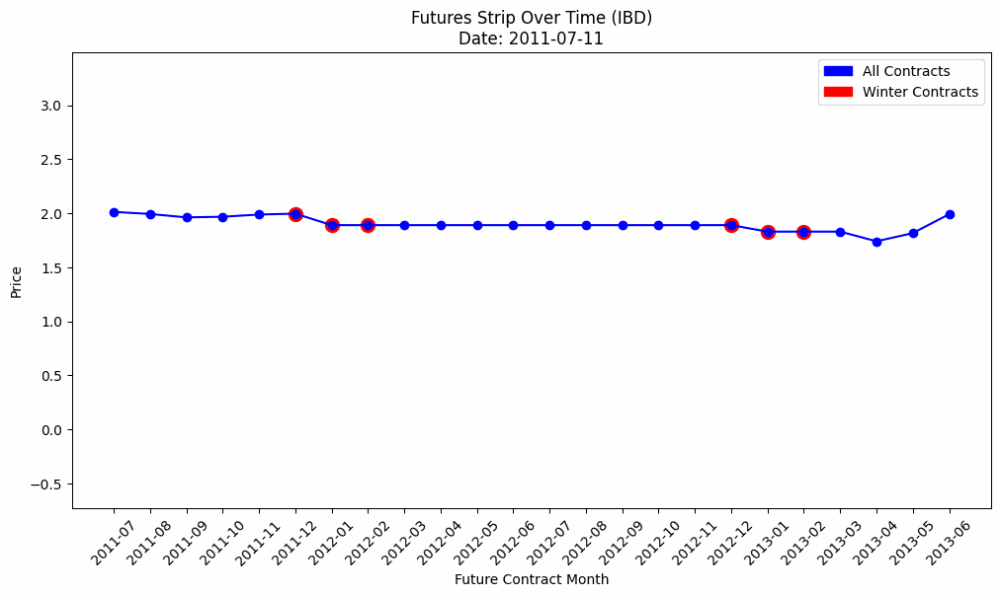

In [7]:
df_ng = load_futures_data(sheet_name="IBD")

import os
import numpy as np
import imageio
import matplotlib.pyplot as plt
from IPython.display import Image, display

def generate_futures_gif(df, sheet_name="IBD", save_path="ibd_futures_full.gif", duration=1000, max_frames=300):
    
    import matplotlib.patches as mpatches
    
    image_folder = "gif_frames"
    os.makedirs(image_folder, exist_ok=True)

    frames = []
    num_contracts = df.shape[1] - 1  # Exclude 'date' column
    total_rows = len(df)

    # Dynamically adjust step to limit frames
    step = max(1, total_rows // max_frames)

    # Select rows to plot (spaced evenly)
    selected_rows = df.iloc[::step].reset_index(drop=True)

    # Predefine legend handles for consistency
    all_contracts_patch = mpatches.Patch(color='blue', label='All Contracts')
    winter_patch = mpatches.Patch(color='red', label='Winter Contracts')

    for i, row in selected_rows.iterrows():
        # Generate dynamic contract months starting from the current date
        start_month = row["date"]
        contract_months = [start_month + pd.DateOffset(months=j) for j in range(num_contracts)]
        contract_labels = [month.strftime("%Y-%m") for month in contract_months]
        prices = row[1:].values

        plt.figure(figsize=(12, 6))

        # Plot all prices
        plt.plot(contract_labels, prices, marker='o', linestyle='-', color='blue')

        # Highlight winter months (Dec-Feb)
        for idx, month in enumerate(contract_months):
            if month.month in [12, 1, 2]:
                plt.scatter(contract_labels[idx], prices[idx], color='red', s=100)

        plt.xlabel("Future Contract Month")
        plt.ylabel("Price")
        plt.title(f"Futures Strip Over Time ({sheet_name})\nDate: {row['date'].strftime('%Y-%m-%d')}")
        plt.xticks(rotation=45)
        plt.ylim(df.iloc[:, 1:].min().min() - 1, df.iloc[:, 1:].max().max() + 1)  # Fixed scale for consistency

        # Static legend added once
        plt.legend(handles=[all_contracts_patch, winter_patch])

        frame_path = os.path.join(image_folder, f"frame_{i:03d}.png")
        plt.savefig(frame_path, bbox_inches="tight")
        plt.close()
        frames.append(frame_path)

    # Create GIF
    with imageio.get_writer(save_path, mode='I', duration=duration / 1000) as writer:
        for frame in frames:
            image = imageio.imread(frame)
            writer.append_data(image)

    print(f"✅ GIF saved at: {save_path} (Frames: {len(frames)}, Step: {step})")
    display(Image(filename=save_path))  # Display the GIF in Jupyter

# Run full-sample GIF generation
generate_futures_gif(df_ng, sheet_name="IBD", save_path="ibd_futures.gif", duration=1000, max_frames=300)

✅ Loaded and cleaned MMB data:


,date,MMB1 Comdty,MMB2 Comdty,MMB3 Comdty,MMB4 Comdty,MMB5 Comdty,MMB6 Comdty,MMB7 Comdty,MMB8 Comdty,MMB9 Comdty,...,MMB15 Comdty,MMB16 Comdty,MMB17 Comdty,MMB18 Comdty,MMB19 Comdty,MMB20 Comdty,MMB21 Comdty,MMB22 Comdty,MMB23 Comdty,MMB24 Comdty
0,2011-07-11,2.43700,2.44208,2.44458,2.44750,2.45125,2.45500,2.45375,2.44375,2.43125,...,2.38125,2.37875,2.37875,2.37875,2.27355,2.27355,2.27355,2.27355,2.27355,2.27355
1,2011-07-12,2.45011,2.46417,2.46708,2.47042,2.47417,2.47792,2.48500,2.47000,2.45250,...,2.40313,2.40125,2.40125,2.40125,2.36875,2.36875,2.36875,2.36875,2.36875,2.36875
2,2011-07-13,2.46866,2.49375,2.49667,2.50000,2.50375,2.50750,2.51125,2.49625,2.47875,...,2.42875,2.42875,2.42875,2.42875,2.43375,2.42375,2.39750,2.39750,2.39750,2.39750
3,2011-07-14,2.45400,2.47042,2.47417,2.47708,2.48042,2.48375,2.48750,2.47250,2.45500,...,2.40500,2.40500,2.40500,2.40500,2.41000,2.40000,2.37375,2.37375,2.37375,2.37375
4,2011-07-15,2.46254,2.48542,2.48917,2.49292,2.49625,2.49958,2.50500,2.49000,2.47250,...,2.42250,2.42250,2.42250,2.42250,2.42750,2.41750,2.39125,2.39125,2.39125,2.39125


/var/folders/r6/6h8mtjj914j_0j9_yn_4cm1m0000gn/T/ipykernel_72373/22620199.py:64: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(frame)


✅ GIF saved at: mmb_futures.gif (Frames: 324, Step: 11)


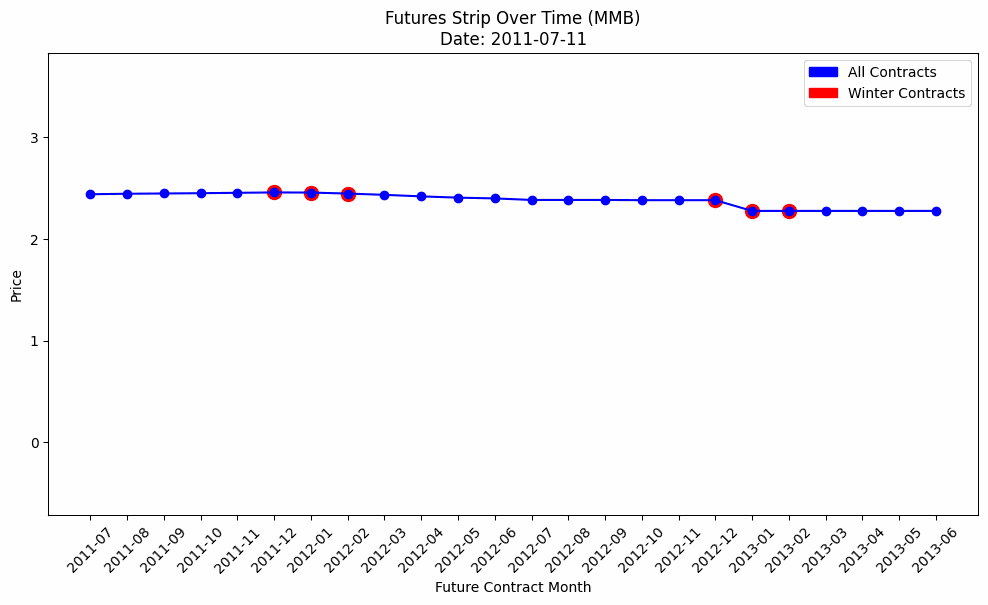

In [8]:
df_ng = load_futures_data(sheet_name="MMB")

import os
import numpy as np
import imageio
import matplotlib.pyplot as plt
from IPython.display import Image, display

def generate_futures_gif(df, sheet_name="MMB", save_path="mmb_futures_full.gif", duration=1000, max_frames=300):
 
    import matplotlib.patches as mpatches
    
    image_folder = "gif_frames"
    os.makedirs(image_folder, exist_ok=True)

    frames = []
    num_contracts = df.shape[1] - 1  # Exclude 'date' column
    total_rows = len(df)

    # Dynamically adjust step to limit frames
    step = max(1, total_rows // max_frames)

    # Select rows to plot (spaced evenly)
    selected_rows = df.iloc[::step].reset_index(drop=True)

    # Predefine legend handles for consistency
    all_contracts_patch = mpatches.Patch(color='blue', label='All Contracts')
    winter_patch = mpatches.Patch(color='red', label='Winter Contracts')

    for i, row in selected_rows.iterrows():
        # Generate dynamic contract months starting from the current date
        start_month = row["date"]
        contract_months = [start_month + pd.DateOffset(months=j) for j in range(num_contracts)]
        contract_labels = [month.strftime("%Y-%m") for month in contract_months]
        prices = row[1:].values

        plt.figure(figsize=(12, 6))

        # Plot all prices
        plt.plot(contract_labels, prices, marker='o', linestyle='-', color='blue')

        # Highlight winter months (Dec-Feb)
        for idx, month in enumerate(contract_months):
            if month.month in [12, 1, 2]:
                plt.scatter(contract_labels[idx], prices[idx], color='red', s=100)

        plt.xlabel("Future Contract Month")
        plt.ylabel("Price")
        plt.title(f"Futures Strip Over Time ({sheet_name})\nDate: {row['date'].strftime('%Y-%m-%d')}")
        plt.xticks(rotation=45)
        plt.ylim(df.iloc[:, 1:].min().min() - 1, df.iloc[:, 1:].max().max() + 1)  # Fixed scale for consistency

        # Static legend added once
        plt.legend(handles=[all_contracts_patch, winter_patch])

        frame_path = os.path.join(image_folder, f"frame_{i:03d}.png")
        plt.savefig(frame_path, bbox_inches="tight")
        plt.close()
        frames.append(frame_path)

    # Create GIF
    with imageio.get_writer(save_path, mode='I', duration=duration / 1000) as writer:
        for frame in frames:
            image = imageio.imread(frame)
            writer.append_data(image)

    print(f"✅ GIF saved at: {save_path} (Frames: {len(frames)}, Step: {step})")
    display(Image(filename=save_path))  # Display the GIF in Jupyter

# Run full-sample GIF generation
generate_futures_gif(df_ng, sheet_name="MMB", save_path="mmb_futures.gif", duration=1000, max_frames=300)

In [9]:
df_ng = load_futures_data(sheet_name="PCW")

import os
import numpy as np
import imageio
import matplotlib.pyplot as plt
from IPython.display import Image, display

def generate_futures_gif(df, sheet_name="PCW", save_path="pcw_futures_full.gif", duration=1000, max_frames=300):
  
    import matplotlib.patches as mpatches
    
    image_folder = "gif_frames"
    os.makedirs(image_folder, exist_ok=True)

    frames = []
    num_contracts = df.shape[1] - 1  # Exclude 'date' column
    total_rows = len(df)

    # Dynamically adjust step to limit frames
    step = max(1, total_rows // max_frames)

    # Select rows to plot (spaced evenly)
    selected_rows = df.iloc[::step].reset_index(drop=True)

    # Predefine legend handles for consistency
    all_contracts_patch = mpatches.Patch(color='blue', label='All Contracts')
    winter_patch = mpatches.Patch(color='red', label='Winter Contracts')

    for i, row in selected_rows.iterrows():
        # Generate dynamic contract months starting from the current date
        start_month = row["date"]
        contract_months = [start_month + pd.DateOffset(months=j) for j in range(num_contracts)]
        contract_labels = [month.strftime("%Y-%m") for month in contract_months]
        prices = row[1:].values

        plt.figure(figsize=(12, 6))

        # Plot all prices
        plt.plot(contract_labels, prices, marker='o', linestyle='-', color='blue')

        # Highlight winter months (Dec-Feb)
        for idx, month in enumerate(contract_months):
            if month.month in [12, 1, 2]:
                plt.scatter(contract_labels[idx], prices[idx], color='red', s=100)

        plt.xlabel("Future Contract Month")
        plt.ylabel("Price")
        plt.title(f"Futures Strip Over Time ({sheet_name})\nDate: {row['date'].strftime('%Y-%m-%d')}")
        plt.xticks(rotation=45)
        plt.ylim(df.iloc[:, 1:].min().min() - 1, df.iloc[:, 1:].max().max() + 1)  # Fixed scale for consistency

        # Static legend added once
        plt.legend(handles=[all_contracts_patch, winter_patch])

        frame_path = os.path.join(image_folder, f"frame_{i:03d}.png")
        plt.savefig(frame_path, bbox_inches="tight")
        plt.close()
        frames.append(frame_path)

    # Create GIF
    with imageio.get_writer(save_path, mode='I', duration=duration / 1000) as writer:
        for frame in frames:
            image = imageio.imread(frame)
            writer.append_data(image)

    print(f"✅ GIF saved at: {save_path} (Frames: {len(frames)}, Step: {step})")
    display(Image(filename=save_path))  # Display the GIF in Jupyter

# Run full-sample GIF generation
generate_futures_gif(df_ng, sheet_name="PCW", save_path="pcw_futures.gif", duration=1000, max_frames=300)

✅ Loaded and cleaned PCW data:


,date,PCW1 Comdty,PCW2 Comdty,PCW3 Comdty,PCW4 Comdty,PCW5 Comdty,PCW5 Comdty.1,PCW6 Comdty,PCW7 Comdty,PCW8 Comdty,...,PCW15 Comdty,PCW16 Comdty,PCW17 Comdty,PCW18 Comdty,PCW19 Comdty,PCW20 Comdty,PCW21 Comdty,PCW22 Comdty,PCW23 Comdty,PCW24 Comdty
0,2011-07-07,0.5750,0.57125,0.5675,0.56375,0.56000,0.56000,0.55625,0.535,0.56875,...,0.35875,0.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2011-07-08,0.5675,0.56500,0.5625,0.56000,0.55875,0.55875,0.55750,0.535,0.56875,...,0.35875,0.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2011-07-11,0.5675,0.56500,0.5625,0.56000,0.55875,0.55875,0.55750,0.535,0.56875,...,0.35875,0.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2011-07-12,0.5675,0.56500,0.5625,0.56000,0.55750,0.55750,0.55500,0.535,0.56875,...,0.35875,0.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2011-07-13,0.5600,0.55750,0.5550,0.55250,0.55125,0.55125,0.55000,0.535,0.56875,...,0.35875,0.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


ConversionError: Failed to convert value(s) to axis units: masked_array(data=[--],
             mask=[ True],
       fill_value=1e+20,
            dtype=float64)

ConversionError: Failed to convert value(s) to axis units: masked_array(data=[--],
             mask=[ True],
       fill_value=1e+20,
            dtype=float64)

<Figure size 1200x600 with 1 Axes>

Loaded and cleaned PGP data:


,date,PGP1 Comdty,PGP2 Comdty,PGP3 Comdty,PGP4 Comdty,PGP5 Comdty,PGP6 Comdty,PGP6 Comdty.1,PGP7 Comdty,PGP8 Comdty,...,PGP15 Comdty,PGP16 Comdty,PGP17 Comdty,PGP18 Comdty,PGP19 Comdty,PGP20 Comdty,PGP21 Comdty,PGP22 Comdty,PGP23 Comdty,PGP24 Comdty
0,2011-07-07,0.76125,0.7600,0.75875,0.7575,0.75750,0.7575,0.7575,0.7575,0.7575,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2011-07-08,0.76125,0.7600,0.75875,0.7575,0.75750,0.7575,0.7575,0.7575,0.7575,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2011-07-11,0.76125,0.7600,0.75875,0.7575,0.75750,0.7575,0.7575,0.7575,0.7575,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2011-07-12,0.77000,0.7775,0.78375,0.7900,0.79625,0.8025,0.8025,0.8025,0.8025,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2011-07-13,0.77000,0.7750,0.78250,0.7900,0.79750,0.8050,0.8050,0.8050,0.8050,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


/var/folders/r6/6h8mtjj914j_0j9_yn_4cm1m0000gn/T/ipykernel_20254/1083883399.py:40: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(frame)


✅ GIF saved at: pgp_futures.gif (Frames: 324, Step: 11)


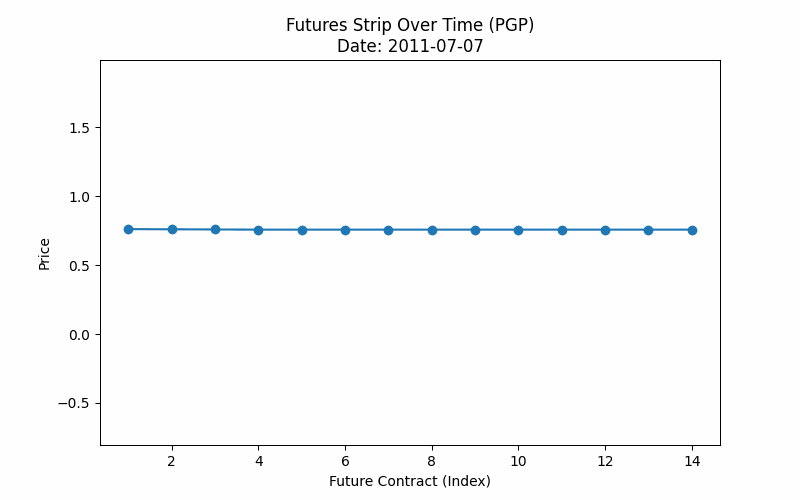

In [ ]:
df_ng = load_futures_data(sheet_name="PGP")

import os
import numpy as np
import imageio
import matplotlib.pyplot as plt
from IPython.display import Image, display

def generate_futures_gif(df, sheet_name="PGP", save_path="pgp_futures_full.gif", duration=1000, max_frames=300):

    import matplotlib.patches as mpatches
    
    image_folder = "gif_frames"
    os.makedirs(image_folder, exist_ok=True)

    frames = []
    num_contracts = df.shape[1] - 1  # Exclude 'date' column
    total_rows = len(df)

    # Dynamically adjust step to limit frames
    step = max(1, total_rows // max_frames)

    # Select rows to plot (spaced evenly)
    selected_rows = df.iloc[::step].reset_index(drop=True)

    # Predefine legend handles for consistency
    all_contracts_patch = mpatches.Patch(color='blue', label='All Contracts')
    winter_patch = mpatches.Patch(color='red', label='Winter Contracts')

    for i, row in selected_rows.iterrows():
        # Generate dynamic contract months starting from the current date
        start_month = row["date"]
        contract_months = [start_month + pd.DateOffset(months=j) for j in range(num_contracts)]
        contract_labels = [month.strftime("%Y-%m") for month in contract_months]
        prices = row[1:].values

        plt.figure(figsize=(12, 6))

        # Plot all prices
        plt.plot(contract_labels, prices, marker='o', linestyle='-', color='blue')

        # Highlight winter months (Dec-Feb)
        for idx, month in enumerate(contract_months):
            if month.month in [12, 1, 2]:
                plt.scatter(contract_labels[idx], prices[idx], color='red', s=100)

        plt.xlabel("Future Contract Month")
        plt.ylabel("Price")
        plt.title(f"Futures Strip Over Time ({sheet_name})\nDate: {row['date'].strftime('%Y-%m-%d')}")
        plt.xticks(rotation=45)
        plt.ylim(df.iloc[:, 1:].min().min() - 1, df.iloc[:, 1:].max().max() + 1)  # Fixed scale for consistency

        # Static legend added once
        plt.legend(handles=[all_contracts_patch, winter_patch])

        frame_path = os.path.join(image_folder, f"frame_{i:03d}.png")
        plt.savefig(frame_path, bbox_inches="tight")
        plt.close()
        frames.append(frame_path)

    # Create GIF
    with imageio.get_writer(save_path, mode='I', duration=duration / 1000) as writer:
        for frame in frames:
            image = imageio.imread(frame)
            writer.append_data(image)

    print(f"✅ GIF saved at: {save_path} (Frames: {len(frames)}, Step: {step})")
    display(Image(filename=save_path))  # Display the GIF in Jupyter

# Run full-sample GIF generation
generate_futures_gif(df_ng, sheet_name="PGP", save_path="pgp_futures.gif", duration=1000, max_frames=300)